# HR Analytics

### Problem Statement

Your client is a large MNC and they have 9 broad verticals across the organisation. One of the problem your client is facing is around identifying the right people for promotion (only for manager position and below) and prepare them in time. Currently the process, they are following is:

They first identify a set of employees based on recommendations/ past performance
Selected employees go through the separate training and evaluation program for each vertical. These programs are based on the required skill of each vertical
At the end of the program, based on various factors such as training performance, KPI completion (only employees with KPIs completed greater than 60% are considered) etc., employee gets promotion
For above mentioned process, the final promotions are only announced after the evaluation and this leads to delay in transition to their new roles. Hence, company needs your help in identifying the eligible candidates at a particular checkpoint so that they can expedite the entire promotion cycle. 

They have provided multiple attributes around Employee's past and current performance along with demographics. Now, The task is to predict whether a potential promotee at checkpoint in the test set will be promoted or not after the evaluation process.

In [2]:
pip install jupyter_contrib_nbextensions && jupyter contrib nbextension install

  Created wheel for jupyter-latex-envs: filename=jupyter_latex_envs-1.4.6-py2.py3-none-any.whl size=963399 sha256=c16f0a005b0d64efc7e5959ef10c4d38d9d71ec5899b25c27a4d56b88922a24b
  Stored in directory: c:\users\sony-pc\appdata\local\pip\cache\wheels\4d\ba\f4\b8c0941055519ebc0f27e85bfe2bb223f1a59a3b8bfc5c7515
  Created wheel for jupyter-nbextensions-configurator: filename=jupyter_nbextensions_configurator-0.4.1-py2.py3-none-any.whl size=465829 sha256=f2f43e54c02c865432e9696f96ee3a289375c0cb3e380cfbfcaff7d7ab7d6432
  Stored in directory: c:\users\sony-pc\appdata\local\pip\cache\wheels\e3\3a\b3\a709b437602c3807f079f0c35ccba3e1adf9af6f2e6b0ebfea
Successfully built jupyter-latex-envs jupyter-nbextensions-configurator



[I 12:35:40 InstallContribNbextensionsApp] jupyter contrib nbextension install 
[I 12:35:40 InstallContribNbextensionsApp] Installing jupyter_contrib_nbextensions nbextension files to jupyter data directory
[I 12:35:41 InstallContribNbextensionsApp] Installing c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\addbefore -> addbefore
[I 12:35:41 InstallContribNbextensionsApp] Making directory: C:\ProgramData\jupyter\nbextensions\addbefore\
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\addbefore\addbefore.yaml -> C:\ProgramData\jupyter\nbextensions\addbefore\addbefore.yaml
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\addbefore\icon.png -> C:\ProgramData\jupyter\nbextensions\addbefore\icon.png
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda

[I 12:35:41 InstallContribNbextensionsApp] Up to date: C:\ProgramData\jupyter\nbextensions\code_prettify\README_2to3.md
[I 12:35:41 InstallContribNbextensionsApp] Up to date: C:\ProgramData\jupyter\nbextensions\code_prettify\README_autopep8.md
[I 12:35:41 InstallContribNbextensionsApp] Up to date: C:\ProgramData\jupyter\nbextensions\code_prettify\README_code_prettify.md
[I 12:35:41 InstallContribNbextensionsApp] Up to date: C:\ProgramData\jupyter\nbextensions\code_prettify\README_isort.md
[I 12:35:41 InstallContribNbextensionsApp] - Validating: ok
[I 12:35:41 InstallContribNbextensionsApp] Installing c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\collapsible_headings -> collapsible_headings
[I 12:35:41 InstallContribNbextensionsApp] Making directory: C:\ProgramData\jupyter\nbextensions\collapsible_headings\
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\co

[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\gist_it\gist_it.yaml -> C:\ProgramData\jupyter\nbextensions\gist_it\gist_it.yaml
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\gist_it\icon.png -> C:\ProgramData\jupyter\nbextensions\gist_it\icon.png
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\gist_it\main.js -> C:\ProgramData\jupyter\nbextensions\gist_it\main.js
[I 12:35:41 InstallContribNbextensionsApp] Copying: c:\users\sony-pc\anaconda3\lib\site-packages\jupyter_contrib_nbextensions\nbextensions\gist_it\readme.md -> C:\ProgramData\jupyter\nbextensions\gist_it\readme.md
[I 12:35:41 InstallContribNbextensionsApp] - Validating: ok
[I 12:35:41 InstallContribNbextensionsApp] Installing c:\users\sony-pc\anaconda3\lib

In [408]:
#Importing the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import re
import os
import pathlib
import seaborn as sn
import plotly.express as pe
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [409]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

In [410]:
pd.set_option("display.precision" , 2)

In [411]:
#Set the paths to read the dataset
path = r'D://HR Analytics//'
train_path = os.path.join(path, 'train_set.csv')
test_path = os.path.join(path, "test_set.csv")

In [412]:
#Read the data from the files
train_data = pd.read_csv(train_path)
test_data = pd.read_csv(test_path)

In [413]:
#Loading the dataset
train_df = pd.DataFrame(train_data)
test_df = pd.DataFrame(test_data)

#A peek at the data
train_df.head()

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
0,65438,Sales & Marketing,region_7,Master's & above,f,sourcing,1,35,5.0,8,1,0,49,0
1,65141,Operations,region_22,Bachelor's,m,other,1,30,5.0,4,0,0,60,0
2,7513,Sales & Marketing,region_19,Bachelor's,m,sourcing,1,34,3.0,7,0,0,50,0
3,2542,Sales & Marketing,region_23,Bachelor's,m,other,2,39,1.0,10,0,0,50,0
4,48945,Technology,region_26,Bachelor's,m,other,1,45,3.0,2,0,0,73,0


In [414]:
#Basic information about the datatypes and names of features
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54808 entries, 0 to 54807
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   employee_id           54808 non-null  int64  
 1   department            54808 non-null  object 
 2   region                54808 non-null  object 
 3   education             52399 non-null  object 
 4   gender                54808 non-null  object 
 5   recruitment_channel   54808 non-null  object 
 6   no_of_trainings       54808 non-null  int64  
 7   age                   54808 non-null  int64  
 8   previous_year_rating  50684 non-null  float64
 9   length_of_service     54808 non-null  int64  
 10  KPIs_met >80%         54808 non-null  int64  
 11  awards_won?           54808 non-null  int64  
 12  avg_training_score    54808 non-null  int64  
 13  is_promoted           54808 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.9+ MB


In [415]:
#Total number of missing values
train_df.isna().sum()/train_df.shape[0]*100,2

(employee_id             0.00
 department              0.00
 region                  0.00
 education               4.40
 gender                  0.00
 recruitment_channel     0.00
 no_of_trainings         0.00
 age                     0.00
 previous_year_rating    7.52
 length_of_service       0.00
 KPIs_met >80%           0.00
 awards_won?             0.00
 avg_training_score      0.00
 is_promoted             0.00
 dtype: float64,
 2)

- There are some null values in the education and previous_year_rating columns

In [416]:
test_df.isna().sum()/test_df.shape[0]*100

employee_id             0.00
department              0.00
region                  0.00
education               4.40
gender                  0.00
recruitment_channel     0.00
no_of_trainings         0.00
age                     0.00
previous_year_rating    7.71
length_of_service       0.00
KPIs_met >80%           0.00
awards_won?             0.00
avg_training_score      0.00
dtype: float64

#### Imputing Missing Values
Leaving the missing details in categorical column as it as whereas imputing those for the feature previous_year_rating

In [417]:
#Imputing the missing values with 0 for the previous_year_rating column in train and test dataset 
train_df["previous_year_rating"].fillna(value = 0, inplace = True)
test_df["previous_year_rating"].fillna(value = 0, inplace = True)

In [418]:
#Some description of the numeric data
train_df.select_dtypes(exclude = "object").describe()

,employee_id,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
count,54808.00,54808.00,54808.00,54808.00,54808.00,54808.00,54808.00,54808.00,54808.00
mean,39195.83,1.25,34.80,3.08,5.87,0.35,0.02,63.39,0.09
std,22586.58,0.61,7.66,1.50,4.27,0.48,0.15,13.37,0.28
min,1.00,1.00,20.00,0.00,1.00,0.00,0.00,39.00,0.00
25%,19669.75,1.00,29.00,2.00,3.00,0.00,0.00,51.00,0.00
50%,39225.50,1.00,33.00,3.00,5.00,0.00,0.00,60.00,0.00
75%,58730.50,1.00,39.00,4.00,7.00,1.00,0.00,76.00,0.00
max,78298.00,10.00,60.00,5.00,37.00,1.00,1.00,99.00,1.00


In [419]:
#Brief description of the object data
train_df.select_dtypes(include = "object").describe()

,department,region,education,gender,recruitment_channel
count,54808,54808,52399,54808,54808
unique,9,34,3,2,3
top,Sales & Marketing,region_2,Bachelor's,m,other
freq,16840,12343,36669,38496,30446


#### Binning few columns
Creating categorical columns for some numerical features to better learn relationships

In [420]:
#Function to create categorical features
def num_to_cat(df, column, bins_list, labels_list):
    new_col = pd.cut(df[column], bins = bins_list, labels = labels_list)
    insert_at = df.columns.get_loc(column) + 1
    df.insert(loc = insert_at, column = "cat_"+column, value = new_col)

In [421]:
#Train_df columns
num_to_cat(train_df, "length_of_service", [0,10,20,40], ["Less than 10 yrs", "10 - 20 yrs", "20 plus yrs"])
num_to_cat(train_df,"age", [20,30,40,50,80], ["Less than 30 yrs", "30 - 40 yrs", "40 - 50 yrs", "50 plus yrs"])
num_to_cat(train_df, "avg_training_score", [0,20,40,60,80,100], ["Less than 20","20 - 40", "40 - 60", "60 - 80", "80 - 100"])

#Test_df columns
num_to_cat(test_df, "length_of_service", [0,10,20,40], ["Less than 10 yrs", "10 - 20 yrs", "20 plus yrs"])
num_to_cat(test_df,"age", [20,30,40,50,80], ["Less than 30 yrs", "30 - 40 yrs", "40 - 50 yrs", "50 plus yrs"])
num_to_cat(test_df, "avg_training_score", [0,20,40,60,80,100], ["Less than 20","20 - 40", "40 - 60", "60 - 80", "80 - 100"])

### Exploratory Data Analysis

#### Univariate Analysis

In [422]:
fig = make_subplots(rows = 3, cols = 2, vertical_spacing= 0.2 ,
                   subplot_titles=("Education", "Department", "Gender", "Recruitment Channel", "Region"),
                   specs=[[{}, {}], [{},{}],
                   [{"colspan": 2}, None]],)

fig.add_trace(go.Histogram(x = train_df["education"], name = "Education", histnorm = "percent"), row = 1, col = 1)

fig.add_trace(go.Histogram(x = train_df["department"], name = "Department", histnorm = "percent"), row = 1, col = 2)

fig.add_trace(go.Histogram(x = train_df["gender"], name = "Gender", histnorm = "percent"), row = 2, col = 1)

fig.add_trace(go.Histogram(x = train_df["recruitment_channel"], name = "Recruitment Channel", histnorm = "percent"), row = 2, col = 2)

fig.add_trace(go.Histogram(x = train_df["region"], name = "Region", histnorm = "percent"), row = 3, col = 1)

fig.update_layout(height=700, showlegend=False)

- Approximately 70% of the candidates hold a Bachelor's Degree whereas a small percentage of candidates have no college degree.
- There is a huge gender gap between the candidates. More than 70% of the candidates are male.
- Most of candidates are from the sales and operations department and very few from R&D and legal department. 
- Very few candidates are shortlisted via referrals whereas a large portion of them are shortlisted via sourcing.
- Candidates from Regions -2, 7 and 33 form majority of the pool of the shortlisted candidates.

In [423]:
fig = make_subplots(rows = 2, cols = 2, vertical_spacing= 0.1 ,
                   subplot_titles=("No. of Trainings", "KPIs met > 80%", "Previous Year Ratings", "Length of Service",
                                  "Average Training Score", "Awards won", "Age", "Is Promoted"),)

fig.add_trace(go.Histogram(x = train_df["no_of_trainings"], name = "No. of Trainings", histnorm = "percent"), row = 1, col = 1)

fig.add_trace(go.Histogram(x = train_df["KPIs_met >80%"], name = "KPIs met > 80%", histnorm = "percent"), row = 1, col = 2)

fig.add_trace(go.Histogram(x = train_df["previous_year_rating"], name = "Previous Year Rating", histnorm = "percent"), row = 2, col = 1)

fig.add_trace(go.Histogram(x = train_df["cat_length_of_service"], name = "Length of Service", histnorm = "percent"), row = 2, col = 2)



#fig.update_layout(height=1000, showlegend=False)

In [424]:
fig = make_subplots(rows = 2, cols = 2, vertical_spacing= 0.15 ,
                   subplot_titles=("Average Training Score", "Awards won", "Age", "Is Promoted"),)

fig.add_trace(go.Histogram(x = train_df["cat_avg_training_score"], name = "Average Training Score", histnorm = "percent"), row = 1, col = 1)

fig.add_trace(go.Histogram(x = train_df["awards_won?"], name = "Awards Won", histnorm = "percent"), row = 1, col = 2)

fig.add_trace(go.Histogram(x = train_df["cat_age"], name = "Age", histnorm = "percent"), row = 2, col = 1)

fig.add_trace(go.Histogram(x = train_df["is_promoted"], name = "Is Promoted"), row = 2, col =2)

#fig.update_layout(height=1000, showlegend=False)

#### Is Promoted

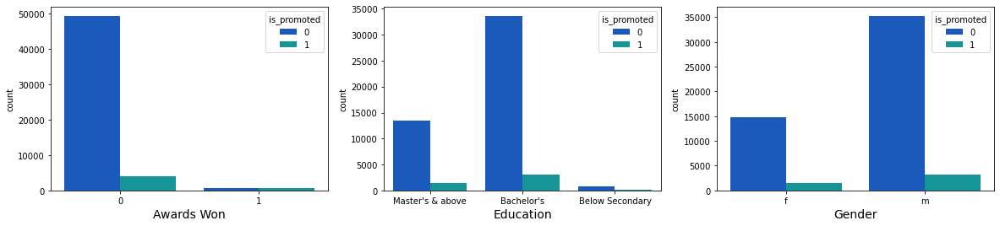

In [425]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "awards_won?", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Awards Won", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "education", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Education", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "gender", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Gender", fontsize = 14)
plt.show()

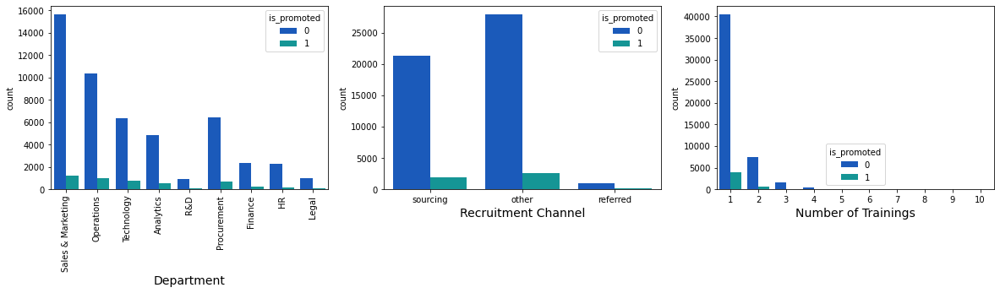

In [426]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "department", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xticks(rotation = 90)
plt.xlabel("Department", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "recruitment_channel", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Recruitment Channel", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "no_of_trainings", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Number of Trainings", fontsize = 14)
plt.show()

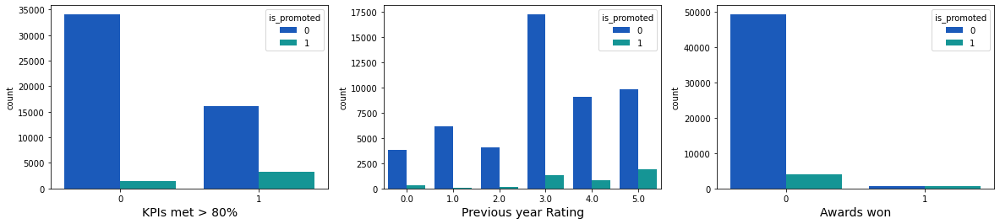

In [427]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "KPIs_met >80%", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("KPIs met > 80%", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "previous_year_rating", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Previous year Rating", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "awards_won?", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Awards won", fontsize = 14)

plt.show()

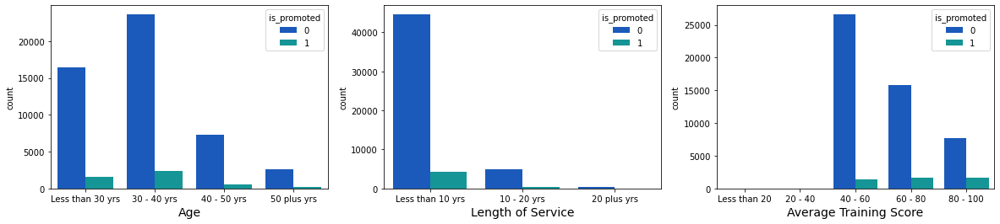

In [428]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "cat_age", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Age", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "cat_length_of_service", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Length of Service", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "cat_avg_training_score", hue ="is_promoted", data=train_df, palette = ("winter"))
plt.xlabel("Average Training Score", fontsize = 14)
plt.show()

#### KPIs met > 80%

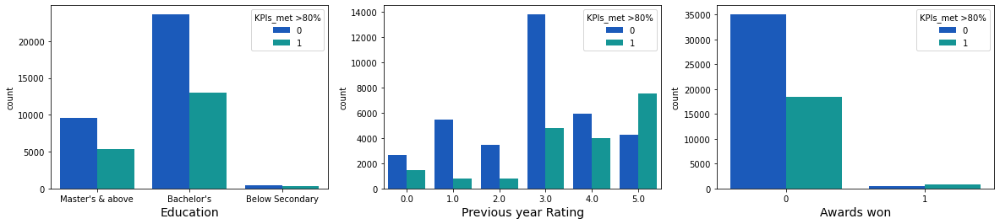

In [429]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "education", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Education", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "previous_year_rating", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Previous year Rating", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "awards_won?", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Awards won", fontsize = 14)

plt.show()

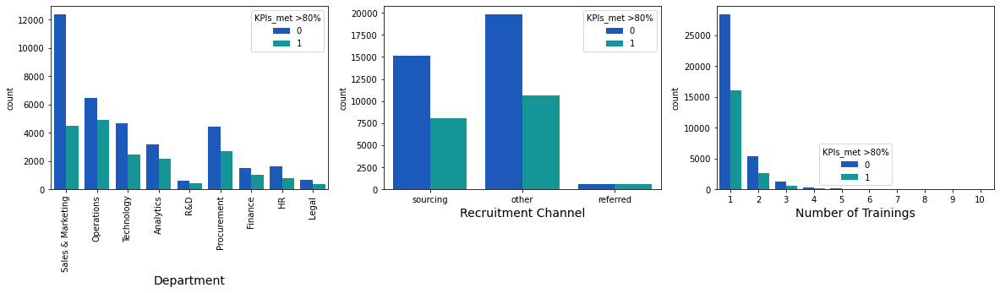

In [430]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "department", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Department", fontsize = 14)
plt.xticks(rotation = 90)

plt.subplot(1,3,2)
sn.countplot(x = "recruitment_channel", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Recruitment Channel", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "no_of_trainings", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Number of Trainings", fontsize = 14)
plt.show()

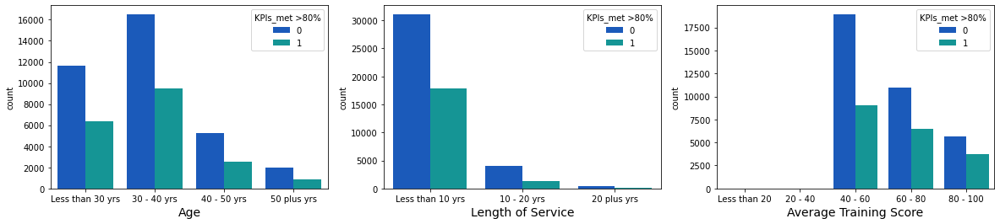

In [431]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "cat_age", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Age", fontsize = 14)

plt.subplot(1,3,2)
sn.countplot(x = "cat_length_of_service", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Length of Service", fontsize = 14)

plt.subplot(1,3,3)
sn.countplot(x = "cat_avg_training_score", hue ="KPIs_met >80%", data=train_df, palette = ("winter"))
plt.xlabel("Average Training Score", fontsize = 14)
plt.show()

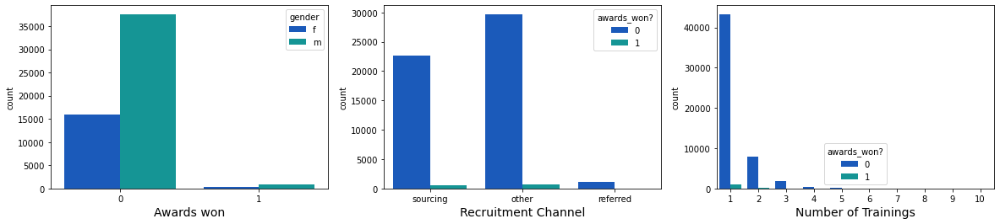

In [432]:
plt.figure(figsize = (20,4))
plt.subplot(1,3,1)
sn.countplot(x = "awards_won?", hue ="gender", data=train_df, palette = ("winter"))
plt.xlabel("Awards won", fontsize = 14)
#with_hue(ax, train_df["awards_won?"], 2, 2)

plt.subplot(1,3,2)
sn.countplot(x = "recruitment_channel", hue ="awards_won?", data=train_df, palette = ("winter"))
plt.xlabel("Recruitment Channel", fontsize = 14)
#with_hue(ax, train_df["recruitment_channel"], 3, 2)

plt.subplot(1,3,3)
sn.countplot(x = "no_of_trainings", hue ="awards_won?", data=train_df, palette = ("winter"))
plt.xlabel("Number of Trainings", fontsize = 14)

plt.show()

In [433]:
#Importing necessary libraries from sklearn
from sklearn.model_selection import train_test_split, KFold, GridSearchCV
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, BaggingClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.metrics import f1_score, precision_recall_curve, roc_curve, confusion_matrix, recall_score, precision_score

### Separating input features and labels

In [434]:
#Dividing the data_set into x and y
y = train_df.pop("is_promoted")
X = train_df


In [435]:
#Setting employee id as the index
X.set_index("employee_id", inplace = True)
test_df.set_index("employee_id", inplace = True)

In [436]:
#Dropping few features
to_drop = ["age", "avg_training_score", "length_of_service"]
X.drop(columns = to_drop, inplace = True)
test_df.drop(columns = to_drop, inplace = True)

In [437]:
#Creating one hot vectors for categorical data
columns = X.columns
to_encode = columns.drop(["no_of_trainings", "previous_year_rating"])
X = pd.get_dummies(X, columns = to_encode, drop_first = True )
test_df = pd.get_dummies(test_df, columns = to_encode, drop_first = True)

In [438]:
#splitting the dataset into train and test set
train_X, val_X, train_y, val_y = train_test_split(X, y, test_size = 0.2, random_state = 42)

### Scaling the dataframes

In [447]:
from sklearn.preprocessing import MinMaxScaler

In [448]:
#Scaling the Training set
scaler = MinMaxScaler()
train_X.loc[:,:] = scaler.fit_transform(train_X)

C:\Users\sony-pc\anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [449]:
#Transforming the validation and test sets
val_X.iloc[:,:] = scaler.transform(val_X)
test_df.iloc[:,:] = scaler.transform(test_df)

C:\Users\sony-pc\anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### PCA to reduce the number of features

In [450]:
#reducing the number of features
dic = {}
num_of_features = train_X.shape[1]
for i in range(10, num_of_features, 5):
    pca = PCA(n_components = i, random_state = 42).fit(train_X)
    dic[i] = np.sum(pca.explained_variance_ratio_)

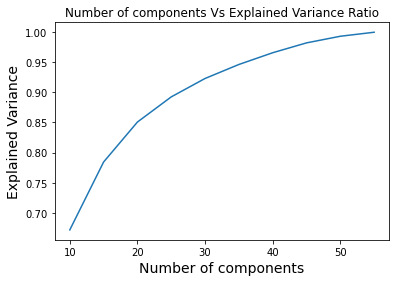

In [451]:
#Plotting a graph between the number of components and explained variance
no_of_components = list(dic.keys())
explained_variance = list(dic.values())
plt.plot(no_of_components, explained_variance)
plt.xlabel("Number of components", fontsize = 14)
plt.ylabel("Explained Variance", fontsize = 14)
plt.title("Number of components Vs Explained Variance Ratio")
plt.show()

In [452]:
#Reducing the number of components to those that are able to explain 95% of the variance in the training dataset
pca = PCA(0.95)
train_X_transformed = pd.DataFrame(pca.fit_transform(train_X), index = train_X.index)

In [454]:
train_X_transformed.shape

(43846, 36)

In [455]:
#Transforming the val_X and test_df set also
val_X_transformed = pd.DataFrame(pca.transform(val_X), index = val_X.index)
test_df_transformed = pd.DataFrame(pca.transform(test_df), index = test_df.index)

#### Functions to plot  and print the validation metrics

In [456]:
#Function to plot the precision recall curve
def plot_precision_recall_curve(y_true, pred_prob):
    precision, recall, thresholds = precision_recall_curve(y_true, pred_prob)
    precision = list(precision)
    precision.pop()
    recall = list(recall)
    recall.pop()

    plt.plot(thresholds, precision, label = "Precision")
    plt.plot(thresholds, recall, label = "Recall")
    plt.xlabel("Threshold", fontsize= 14)
    plt.legend()
    plt.title("Precision Recall Curve", fontsize = 16)
    plt.show()

In [457]:
#Plot the f1_score curve for different threshold values
def plot_f1_curve(y_true, y_pred_prob):
    thresholds = [i/100 for i in range(0, 100, 5)]
    f1_scores = []
    for value in thresholds:
        y_pred = [1 if i >= value else 0 for i in y_pred_prob]
        f1_scores.append(round(f1_score(y_true, y_pred), 2))

    plt.plot(thresholds, f1_scores)
    plt.show()

In [458]:
#Display the confusion matrix
def show_confusion(y_true, y_pred):
    confusion = pd.DataFrame(confusion_matrix(train_y, train_pred), 
                             index = [["Actual","Actual"], ["Not_promoted", "Promoted"]], 
                             columns = ["Not_promoted", "Promoted"])
    return confusion

In [459]:
def print_all_score(y_true, y_pred, data_set_type):
    precision = round(precision_score(y_true, y_pred),2)
    recall = round(recall_score(y_true, y_pred), 2)
    f1 = round(f1_score(y_true, y_pred), 2)
    print(f"The precision score on the {data_set_type} set is {precision}")
    print(f"The recall score on the {data_set_type} set is {recall}")
    print(f"The F1 score on the {data_set_type} set is {f1}")
    return precision, recall, f1

In [460]:
#Storing each models results in a data frame for comparison
results_df = pd.DataFrame( columns = ["Algorithm","f1_train", "f1_test", 
                                      "Recall_train", "Recall_test", 
                                      "Precision_train", "Precision_test", "Cut_off_prob"])

#Method to append each models results
def add_results(model,f1_train, f1_test, recall_train, recall_test, precision_train, precision_test, cut_off_prob):
        df = pd.DataFrame([[model, f1_train, f1_test, recall_train, recall_test, 
                            precision_train, precision_test, cut_off_prob]], 
                          columns = ["Algorithm","f1_train", "f1_test", 
                                      "Recall_train", "Recall_test", 
                                      "Precision_train", "Precision_test", "Cut_off_prob"])
        return results_df.append(df, ignore_index = True)
   

### Model 1

In [461]:
#Training a model using Logistic Regression ALgorithm
lr = LogisticRegression(max_iter=500).fit(train_X_transformed, train_y)

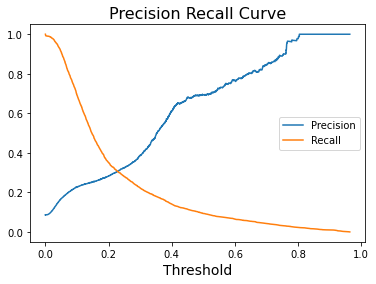

In [462]:
#Predicting the probabilties and plotting a curve
train_pred_prob = lr.predict_proba(train_X_transformed)[:,1]
plot_precision_recall_curve(train_y, train_pred_prob)

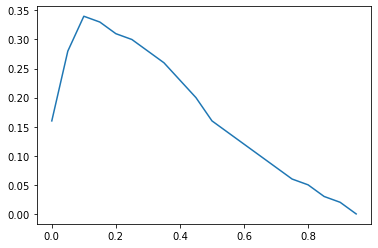

In [463]:
#Plotting a F1_curve
plot_f1_curve(train_y, train_pred_prob)

In [464]:
#Making Classification at a threshold of 0.1 
train_pred = [1 if i >= 0.1 else 0 for i in train_pred_prob]

In [465]:
#Confusion Matrix
show_confusion(train_y, train_pred)

Not_promoted  Promoted
Actual Not_promoted         31207      8879
       Promoted              1154      2606

In [466]:
precision_train, recall_train, f1_train  = print_all_score(train_y, train_pred, "train")

The precision score on the train set is 0.23
The recall score on the train set is 0.69
The F1 score on the train set is 0.34


In [467]:
val_pred_prob = lr.predict_proba(val_X_transformed)[:,1]
#Making Classification at a threshold of 0.4 
val_pred = [1 if i >= 0.1 else 0 for i in val_pred_prob]

In [470]:
precision_val, recall_val, f1_val = print_all_score(val_y, val_pred, "val")

The precision score on the val set is 0.22
The recall score on the val set is 0.7
The F1 score on the val set is 0.34


In [471]:
#Updating the global records table for Logistic Regression
results_df = add_results("Logistic Regression with Class_Imb", f1_train, f1_val, 
                         recall_train, recall_val, precision_train, precision_val, 0.1)
results_df

,Algorithm,f1_train,f1_test,Recall_train,Recall_test,Precision_train,Precision_test,Cut_off_prob
0,Logistic Regression with Class_Imb,0.34,0.34,0.69,0.7,0.23,0.22,0.1


### Model 2 - Logistic Regression with Downsampled dataset

The poor results may be the cause of having an imbalanced dataset which is why we will downsample the training set and observe the results on the same.

In [472]:
train_y.value_counts()

0    40086
1     3760
Name: is_promoted, dtype: int64

In [473]:
#Importing the method to do undersampling
from imblearn.under_sampling import RandomUnderSampler

In [474]:
new_X, new_y = RandomUnderSampler(sampling_strategy = 1).fit_resample(X,y)

In [475]:
#splitting the dataset into train and test set
train_X, val_X, train_y, val_y = train_test_split(new_X, new_y, test_size = 0.2, random_state = 42)

In [478]:
#reducing the number of features
dic = {}
num_of_features = train_X.shape[1]
for i in range(10, num_of_features, 5):
    pca = PCA(n_components = i, random_state = 42).fit(train_X)
    dic[i] = np.sum(pca.explained_variance_ratio_)

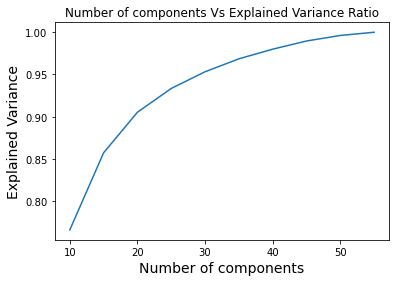

In [479]:
#Plotting a graph between the number of components and explained variance
no_of_components = list(dic.keys())
explained_variance = list(dic.values())
plt.plot(no_of_components, explained_variance)
plt.xlabel("Number of components", fontsize = 14)
plt.ylabel("Explained Variance", fontsize = 14)
plt.title("Number of components Vs Explained Variance Ratio")
plt.show()

In [551]:
#Reducing the number of components to those that are able to explain 95% of the variance in the training dataset
pca = PCA(0.95)
train_X_transformed = pd.DataFrame(pca.fit_transform(train_X), index = train_X.index)

In [552]:
train_X_transformed.shape

(7468, 30)

In [553]:
#Transforming the test_X set also
val_X_transformed = pd.DataFrame(pca.transform(val_X), index = val_X.index)
test_df_transformed = pd.DataFrame(pca.transform(test_df), index = test_df.index)

In [554]:
val_X_transformed.shape

(1868, 30)

In [555]:
#Training a model using Logistic Regression ALgorithm
lr = LogisticRegression(max_iter=500).fit(train_X_transformed, train_y)

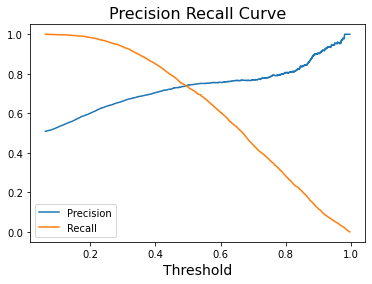

In [556]:
#Predicting the probabilties and plotting a curve
train_pred_prob = lr.predict_proba(train_X_transformed)[:,1]
plot_precision_recall_curve(train_y, train_pred_prob)

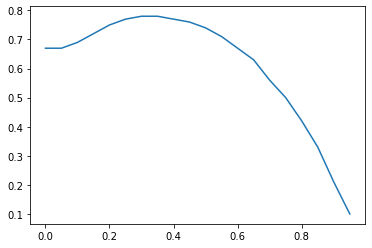

In [557]:
#Plotting a F1_curve
plot_f1_curve(train_y, train_pred_prob)

In [558]:
#Making Classification at a threshold of 0.2 
train_pred = [1 if i >= 0.3 else 0 for i in train_pred_prob]

In [559]:
#Confusion Matrix
show_confusion(train_y, train_pred)

Not_promoted  Promoted
Actual Not_promoted          1953      1784
       Promoted               236      3495

In [560]:
precision_train, recall_train, f1_train = print_all_score(train_y, train_pred, "train")

The precision score on the train set is 0.66
The recall score on the train set is 0.94
The F1 score on the train set is 0.78


In [561]:
val_pred_prob = lr.predict_proba(val_X_transformed)[:,1]
#Making Classification at a threshold of 0.3
val_pred = [1 if i >= 0.3 else 0 for i in val_pred_prob]

In [562]:
precision_val, recall_val, f1_val = print_all_score(val_y, val_pred, "val")

The precision score on the val set is 0.68
The recall score on the val set is 0.93
The F1 score on the val set is 0.78


In [564]:
#Updating the global records table for Logistic Regression
#Updating the global records table for SVM
algorithm = "Logistic Regression"
if results_df["Algorithm"].get(results_df.shape[0]-1) != algorithm: 
    results_df = add_results(algorithm, f1_train, f1_val, 
                             recall_train, recall_val, precision_train, precision_val, 0.3)
results_df


,Algorithm,f1_train,f1_test,Recall_train,Recall_test,Precision_train,Precision_test,Cut_off_prob
0,Logistic Regression with Class_Imb,0.34,0.34,0.69,0.70,0.23,0.22,0.1
1,Support Vector Machine,0.82,0.79,0.90,0.86,0.75,0.73,0.4
2,Logistic Regression,0.78,0.78,0.94,0.93,0.66,0.68,0.3


<b>It is evident that the results obtained after dowmsampling the majority class label are a lot better than without undersampling. </b>

### Model 3 - Support Vector Machine

In [565]:
#Training a model using Logistic Regression ALgorithm
svm = SVC(probability = True).fit(train_X_transformed, train_y)

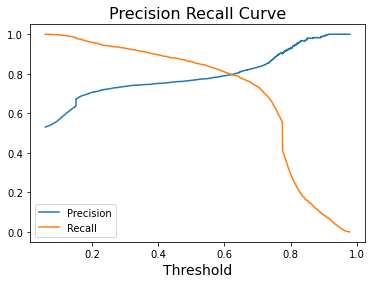

In [566]:
#Predicting the probabilties and plotting a curve
train_pred_prob = svm.predict_proba(train_X_transformed)[:,1]
plot_precision_recall_curve(train_y, train_pred_prob)

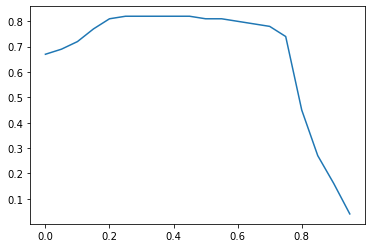

In [567]:
#Plotting a F1_curve
plot_f1_curve(train_y, train_pred_prob)

In [568]:
#Making Classification at a threshold of 0.4 
train_pred = [1 if i >= 0.4 else 0 for i in train_pred_prob]

In [569]:
#Confusion Matrix
show_confusion(train_y, train_pred)

Not_promoted  Promoted
Actual Not_promoted          2630      1107
       Promoted               388      3343

In [570]:
precision_train, recall_train, f1_train = print_all_score(train_y, train_pred, "train")

The precision score on the train set is 0.75
The recall score on the train set is 0.9
The F1 score on the train set is 0.82


In [571]:
val_pred_prob = svm.predict_proba(val_X_transformed)[:,1]
#Making Classification at a threshold of 0.4 
val_pred = [1 if i >= 0.4 else 0 for i in val_pred_prob]

In [572]:
precision_val, recall_val, f1_val = print_all_score(val_y, val_pred, "val")

The precision score on the val set is 0.73
The recall score on the val set is 0.86
The F1 score on the val set is 0.79


In [574]:
#Updating the global records table for SVM
algorithm = "Support Vector Machine"
if results_df["Algorithm"].get(results_df.shape[0]-1) != algorithm: 
    results_df = add_results(algorithm, f1_train, f1_val, 
                             recall_train, recall_val, precision_train, precision_val, 0.4)
results_df

,Algorithm,f1_train,f1_test,Recall_train,Recall_test,Precision_train,Precision_test,Cut_off_prob
0,Logistic Regression with Class_Imb,0.34,0.34,0.69,0.70,0.23,0.22,0.1
1,Logistic Regression,0.78,0.78,0.94,0.93,0.66,0.68,0.3
2,Support Vector Machine,0.82,0.79,0.90,0.86,0.75,0.73,0.4


No improvement in results between Support Vector Machine and Logistic Regression

In [580]:
test_pred_prob = svm.predict_proba(test_df_transformed)[:,1]
test_pred = [1 if i >= 0.4 else 0 for i in test_pred_prob]

In [581]:
len(test_pred)

23490

In [583]:
test_results = pd.DataFrame(test_pred, index = test_df.index)

In [585]:
save_path = os.path.join(path, "test_results.csv")
test_results.to_csv(save_path )

### Model 4 - Multilayered Perceptron

In [587]:
import tensorflow as tf
from keras import Model, layers, losses